## Library version check

In [1]:
import sys
import sktime
import tqdm as tq
import lightgbm as lgb
import matplotlib
import seaborn as sns
import sklearn as skl
import pandas as pd
import numpy as np
print("-------------------------- Python & library version --------------------------")
print("Python version: {}".format(sys.version))
print("pandas version: {}".format(pd.__version__))
print("numpy version: {}".format(np.__version__))
print("matplotlib version: {}".format(matplotlib.__version__))
print("tqdm version: {}".format(tq.__version__))
print("sktime version: {}".format(sktime.__version__))
print("lightgbm version: {}".format(lgb.__version__))
print("seaborn version: {}".format(sns.__version__))
print("scikit-learn version: {}".format(skl.__version__))
print("------------------------------------------------------------------------------")

-------------------------- Python & library version --------------------------
Python version: 3.8.5 (default, Sep  3 2020, 21:29:08) [MSC v.1916 64 bit (AMD64)]
pandas version: 1.5.2
numpy version: 1.21.6
matplotlib version: 3.5.2
tqdm version: 4.64.1
sktime version: 0.20.1
lightgbm version: 3.2.1
seaborn version: 0.11.2
scikit-learn version: 1.1.3
------------------------------------------------------------------------------


## 0. load the libararies

In [2]:
import matplotlib.pyplot as plt
from tqdm import tqdm
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.utils.plotting import plot_series
from lightgbm import LGBMRegressor

pd.set_option('display.max_columns', 30)

## 1. preprocessing the data

In [3]:
train = pd.read_csv('./data/train.csv')
train

,num_date_time,건물번호,일시,기온(C),강수량(mm),풍속(m/s),습도(%),일조(hr),일사(MJ/m2),전력소비량(kWh)
0,1_20220601 00,1,20220601 00,18.6,NaN,0.9,42.0,NaN,NaN,1085.28
1,1_20220601 01,1,20220601 01,18.0,NaN,1.1,45.0,NaN,NaN,1047.36
2,1_20220601 02,1,20220601 02,17.7,NaN,1.5,45.0,NaN,NaN,974.88
3,1_20220601 03,1,20220601 03,16.7,NaN,1.4,48.0,NaN,NaN,953.76
4,1_20220601 04,1,20220601 04,18.4,NaN,2.8,43.0,NaN,NaN,986.40
...,...,...,...,...,...,...,...,...,...,...
203995,100_20220824 19,100,20220824 19,23.1,NaN,0.9,86.0,0.5,NaN,881.04
203996,100_20220824 20,100,20220824 20,22.4,NaN,1.3,86.0,0.0,NaN,798.96
203997,100_20220824 21,100,20220824 21,21.3,NaN,1.0,92.0,NaN,NaN,825.12
203998,100_20220824 22,100,20220824 22,21.0,NaN,0.3,94.0,NaN,NaN,640.08


In [4]:
#전력소비량 이상치 처리(건물번호를 기준)
for num in tqdm(range(train['건물번호'].nunique())):
    train.loc[train['건물번호'] == num+1, '전력소비량(kWh)'] = train.loc[train['건물번호'] == num+1, '전력소비량(kWh)'].clip(train.loc[train['건물번호'] == num+1, '전력소비량(kWh)'].quantile(.01), train.loc[train['건물번호'] == num+1, '전력소비량(kWh)'].quantile(.99))

100%|███████████████████████████████████████████████████████████████████████████████| 100/100 [00:00<00:00, 214.85it/s]


In [5]:
#결측치 확인(train)
def check_missing_col(dataframe):
    missing_col = []
    counted_missing_col = 0
    for i, col in enumerate(dataframe.columns):
        missing_values = sum(dataframe[col].isna())
        is_missing = True if missing_values >= 1 else False
        if is_missing:
            counted_missing_col += 1
            print(f'결측치가 있는 컬럼은: {col}입니다')
            print(f'해당 컬럼에 총 {missing_values}개의 결측치가 존재합니다.')
#            missing_col.append([col, dataframe[col].dtype])
    if counted_missing_col == 0:
        print('결측치가 존재하지 않습니다')
    return "완료"

display(check_missing_col(train))

결측치가 있는 컬럼은: 강수량(mm)입니다
해당 컬럼에 총 160069개의 결측치가 존재합니다.
결측치가 있는 컬럼은: 풍속(m/s)입니다
해당 컬럼에 총 19개의 결측치가 존재합니다.
결측치가 있는 컬럼은: 습도(%)입니다
해당 컬럼에 총 9개의 결측치가 존재합니다.
결측치가 있는 컬럼은: 일조(hr)입니다
해당 컬럼에 총 75182개의 결측치가 존재합니다.
결측치가 있는 컬럼은: 일사(MJ/m2)입니다
해당 컬럼에 총 87913개의 결측치가 존재합니다.


'완료'

In [6]:
#일조, 일사 결측치 처리1
train.loc[train.num_date_time.str[-2:] == "00", "일조(hr)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "01", "일조(hr)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "02", "일조(hr)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "03", "일조(hr)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "04", "일조(hr)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "05", "일조(hr)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "21", "일조(hr)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "22", "일조(hr)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "23", "일조(hr)"] = 0.0

train.loc[train.num_date_time.str[-2:] == "00", "일사(MJ/m2)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "01", "일사(MJ/m2)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "02", "일사(MJ/m2)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "03", "일사(MJ/m2)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "04", "일사(MJ/m2)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "05", "일사(MJ/m2)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "21", "일사(MJ/m2)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "22", "일사(MJ/m2)"] = 0.0
train.loc[train.num_date_time.str[-2:] == "23", "일사(MJ/m2)"] = 0.0

In [7]:
#일조, 일사 결측치 처리2
train.loc[train['일조(hr)'].isna() & train['강수량(mm)'] > 0, "일조(hr)"] = 0.0
train.loc[train['일사(MJ/m2)'].isna() & train['강수량(mm)'] > 0, "일사(MJ/m2)"] = 0.1

In [8]:
#강수량 결측치 처리
train['강수량(mm)'] = train['강수량(mm)'].fillna(0.0)

#일조, 풍속, 습도 결측치 대체
for num in range(1,101,1):
    train.loc[train.건물번호 == num, '일조(hr)'] = np.round(train.loc[train.건물번호 == num, '일조(hr)'].interpolate(method='linear'),1)
    train.loc[train.건물번호 == num, '풍속(m/s)'] = np.round(train.loc[train.건물번호 == num, '풍속(m/s)'].interpolate(method='linear'),1)
    train.loc[train.건물번호 == num, '습도(%)'] = np.round(train.loc[train.건물번호 == num, '습도(%)'].interpolate(method='linear'),1)

In [9]:
#일사 결측치 대체
for num in range(1,101,1):
    train.loc[train.건물번호 == num, '일사(MJ/m2)'] = np.round(train.loc[train.건물번호 == num, '일사(MJ/m2)'].interpolate(method='linear'),2)

In [10]:
#결측치 재확인(train)
def check_missing_col(dataframe):
    missing_col = []
    counted_missing_col = 0
    for i, col in enumerate(dataframe.columns):
        missing_values = sum(dataframe[col].isna())
        is_missing = True if missing_values >= 1 else False
        if is_missing:
            counted_missing_col += 1
            print(f'결측치가 있는 컬럼은: {col}입니다')
            print(f'해당 컬럼에 총 {missing_values}개의 결측치가 존재합니다.')
#            missing_col.append([col, dataframe[col].dtype])
    if counted_missing_col == 0:
        print('결측치가 존재하지 않습니다')
    return "완료"

display(check_missing_col(train))

결측치가 존재하지 않습니다


'완료'

In [11]:
test = pd.read_csv('./data/test.csv')
test

,num_date_time,건물번호,일시,기온(C),강수량(mm),풍속(m/s),습도(%)
0,1_20220825 00,1,20220825 00,23.5,0.0,2.2,72
1,1_20220825 01,1,20220825 01,23.0,0.0,0.9,72
2,1_20220825 02,1,20220825 02,22.7,0.0,1.5,75
3,1_20220825 03,1,20220825 03,22.1,0.0,1.3,78
4,1_20220825 04,1,20220825 04,21.8,0.0,1.0,77
...,...,...,...,...,...,...,...
16795,100_20220831 19,100,20220831 19,22.5,0.0,0.9,84
16796,100_20220831 20,100,20220831 20,20.7,0.0,0.4,95
16797,100_20220831 21,100,20220831 21,20.2,0.0,0.4,98
16798,100_20220831 22,100,20220831 22,20.1,0.0,1.1,97


In [12]:
#결측치 확인(test)
def check_missing_col(dataframe):
    missing_col = []
    counted_missing_col = 0
    for i, col in enumerate(dataframe.columns):
        missing_values = sum(dataframe[col].isna())
        is_missing = True if missing_values >= 1 else False
        if is_missing:
            counted_missing_col += 1
            print(f'결측치가 있는 컬럼은: {col}입니다')
            print(f'해당 컬럼에 총 {missing_values}개의 결측치가 존재합니다.')
#            missing_col.append([col, dataframe[col].dtype])
    if counted_missing_col == 0:
        print('결측치가 존재하지 않습니다')
    return "완료"

display(check_missing_col(test))

결측치가 존재하지 않습니다


'완료'

In [13]:
## 변수들을 영문명으로 변경
cols = ['num_date_time', 'build_num', 'date_time', 'temp' ,'prec', 'wind', 'hum', 'isolation', 'sunshine', 'power']
train.columns = cols

# 시간 관련 변수들 생성
date = pd.to_datetime(train.date_time)
train['date'] = date.dt.date
train['hour'] = date.dt.hour
train['day'] = date.dt.day
train['weekday'] = date.dt.weekday
train['month'] = date.dt.month

isolation = pd.pivot_table(train, values = 'isolation', index = ['build_num', 'hour', 'month'], aggfunc = np.mean).reset_index()
sunshine = pd.pivot_table(train, values = 'sunshine', index = ['build_num', 'hour', 'month'], aggfunc = np.mean).reset_index()

## 건물별, 요일별, 시간별 전력소비량 평균
power_mean_1 = pd.pivot_table(train, values = 'power', index = ['build_num', 'hour', 'weekday'], aggfunc = np.mean).reset_index()
tqdm.pandas()
train['target_mean_1'] = train.progress_apply(lambda x : power_mean_1.loc[(power_mean_1.build_num == x['build_num']) & (power_mean_1.hour == x['hour']) & (power_mean_1.weekday == x['weekday']) ,'power'].values[0], axis = 1)

## 건물별, 요일별, 시간별 전력소비량 표준편차
power_std_1 = pd.pivot_table(train, values = 'power', index = ['build_num', 'hour', 'weekday'], aggfunc = np.std).reset_index()
tqdm.pandas()
train['target_std_1'] = train.progress_apply(lambda x : power_std_1.loc[(power_std_1.build_num == x['build_num']) & (power_std_1.hour == x['hour']) & (power_std_1.weekday == x['weekday']) ,'power'].values[0], axis = 1)


## 공휴일 변수 추가
train['holiday'] = train.apply(lambda x : 0 if x['weekday']<5 else 1, axis = 1)
train.loc[('20220601'<=train.date_time)&(train.date_time<'20220602'),'holiday'] = 1
train.loc[('20220606'<=train.date_time)&(train.date_time<'20220607'),'holiday'] = 1
train.loc[('20220815'<=train.date_time)&(train.date_time<'20220816'),'holiday'] = 1

## https://dacon.io/competitions/official/235680/codeshare/2366?page=1&dtype=recent
train['sin_hour'] = np.sin(2*np.pi*train.hour/24)
train['cos_hour'] = np.cos(2*np.pi*train.hour/24)
train['sin_date'] = -np.sin(2 * np.pi * (train['month']+train['day']/31)/12)
train['cos_date'] = -np.cos(2 * np.pi * (train['month']+train['day']/31)/12)
train['sin_weekday'] = -np.sin(2 * np.pi * (train['weekday']+1)/7.0)
train['cos_weekday'] = -np.cos(2 * np.pi * (train['weekday']+1)/7.0)

## 화씨 온도
train['temp_F'] = (train['temp'] * 9/5) + 32 

## 체감 온도
train['temp2'] = 13.12 + 0.6215*train['temp'] - 11.37*(train['wind']*3.6)**0.16 + 0.3965*(train['wind']*3.6)**0.16*train['temp']

## https://dacon.io/competitions/official/235736/codeshare/2743?page=1&dtype=recent
train['THI'] = 9/5*train['temp'] - 0.55*(1-train['hum']/100)*(9/5*train['hum']-26)+32

def CDH(xs):
    ys = []
    for i in range(len(xs)):
        if i < 11:
            ys.append(np.sum(xs[:(i+1)]-26))
        else:
            ys.append(np.sum(xs[(i-11):(i+1)]-26))
    return np.array(ys)

cdhs = np.array([])
for num in range(1,101,1):
    temp = train[train['build_num'] == num]
    cdh = CDH(temp['temp'].values)
    cdhs = np.concatenate([cdhs, cdh])
train['CDH'] = cdhs

## min temperature
train = train.merge(train.groupby(['build_num','date'])['temp'].min().reset_index().rename(columns = {'temp':'min_temp'}), on = ['build_num','date'], how = 'left')

## max temperature
train = train.merge(train.groupby(['build_num','date'])['temp'].max().reset_index().rename(columns = {'temp':'max_temp'}), on = ['build_num','date'], how = 'left')

## min windspeed
train = train.merge(train.groupby(['build_num','date'])['wind'].min().reset_index().rename(columns = {'wind':'min_wind'}), on = ['build_num','date'], how = 'left')

## max windspeed
train = train.merge(train.groupby(['build_num','date'])['wind'].max().reset_index().rename(columns = {'wind':'max_wind'}), on = ['build_num','date'], how = 'left')

## min humidity
train = train.merge(train.groupby(['build_num','date'])['hum'].min().reset_index().rename(columns = {'hum':'min_hum'}), on = ['build_num','date'], how = 'left')

## max humidity
train = train.merge(train.groupby(['build_num','date'])['hum'].max().reset_index().rename(columns = {'hum':'max_hum'}), on = ['build_num','date'], how = 'left')

## mean THI
train = train.merge(train.groupby(['build_num','date'])['THI'].mean().reset_index().rename(columns = {'THI':'mean_THI'}), on = ['build_num','date'], how = 'left')

## mean CDH
train = train.merge(train.groupby(['build_num','date'])['CDH'].mean().reset_index().rename(columns = {'CDH':'mean_CDH'}), on = ['build_num','date'], how = 'left')

train.drop(columns=['date','day','weekday'], inplace=True)
train.head()

100%|████████████████████████████████████████████████████████████████████████| 204000/204000 [01:57<00:00, 1737.68it/s]


,num_date_time,build_num,date_time,temp,prec,wind,hum,isolation,sunshine,power,hour,month,target_mean_1,target_std_1,holiday,...,cos_date,sin_weekday,cos_weekday,temp_F,temp2,THI,CDH,min_temp,max_temp,min_wind,max_wind,min_hum,max_hum,mean_THI,mean_CDH
0,1_20220601 00,1,20220601 00,18.6,0.0,0.9,42.0,0.0,0.0,1085.28,0,6,1774.744615,517.982222,1,...,0.999857,-0.433884,0.900969,65.48,19.858037,49.6576,-7.4,16.3,28.4,0.9,5.2,19.0,65.0,58.426067,-36.283333
1,1_20220601 01,1,20220601 01,18.0,0.0,1.1,45.0,0.0,0.0,1047.36,1,6,1687.347692,500.769931,1,...,0.999857,-0.433884,0.900969,64.40,19.031307,47.7625,-15.4,16.3,28.4,0.9,5.2,19.0,65.0,58.426067,-36.283333
2,1_20220601 02,1,20220601 02,17.7,0.0,1.5,45.0,0.0,0.0,974.88,2,6,1571.483077,465.227458,1,...,0.999857,-0.433884,0.900969,63.86,18.420654,47.2225,-23.7,16.3,28.4,0.9,5.2,19.0,65.0,58.426067,-36.283333
3,1_20220601 03,1,20220601 03,16.7,0.0,1.4,48.0,0.0,0.0,953.76,3,6,1522.153846,436.601091,1,...,0.999857,-0.433884,0.900969,62.06,17.348120,44.7856,-33.0,16.3,28.4,0.9,5.2,19.0,65.0,58.426067,-36.283333
4,1_20220601 04,1,20220601 04,18.4,0.0,2.8,43.0,0.0,0.0,986.40,4,6,1506.793846,405.518091,1,...,0.999857,-0.433884,0.900969,65.12,18.658787,49.0061,-40.6,16.3,28.4,0.9,5.2,19.0,65.0,58.426067,-36.283333


In [14]:
# train set과 동일한 전처리 과정
cols = ['num_date_time', 'build_num', 'date_time', 'temp' , 'prec', 'wind', 'hum']
test.columns = cols

# 시간 관련 변수들 생성
date = pd.to_datetime(test.date_time)
test['date'] = date.dt.date
test['hour'] = date.dt.hour
test['day'] = date.dt.day
test['weekday'] = date.dt.weekday
test['month'] = date.dt.month

test['holiday'] = test.apply(lambda x : 0 if x['weekday']<5 else 1, axis = 1)

## 일조
tqdm.pandas()
test['isolation'] = np.round(test.progress_apply(lambda x : isolation.loc[(isolation.build_num == x['build_num']) & (isolation.hour == x['hour']) & (isolation.month == x['month']) ,'isolation'].values[0], axis = 1), 1)

## 일사
tqdm.pandas()
test['sunshine'] = np.round(test.progress_apply(lambda x : sunshine.loc[(sunshine.build_num == x['build_num']) & (sunshine.hour == x['hour']) & (sunshine.month == x['month']) ,'sunshine'].values[0], axis = 1), 2)

## 건물별, 요일별, 시간별 전력소비량 평균
tqdm.pandas()
test['target_mean_1'] = test.progress_apply(lambda x : power_mean_1.loc[(power_mean_1.build_num == x['build_num']) & (power_mean_1.hour == x['hour']) & (power_mean_1.weekday == x['weekday']) ,'power'].values[0], axis = 1)

## 건물별, 요일별, 시간별 전력소비량 표준편차
tqdm.pandas()
test['target_std_1'] = test.progress_apply(lambda x : power_std_1.loc[(power_std_1.build_num == x['build_num']) & (power_std_1.hour == x['hour']) & (power_std_1.weekday == x['weekday']) ,'power'].values[0], axis = 1)

test['sin_hour'] = np.sin(2*np.pi*test.hour/24)
test['cos_hour'] = np.cos(2*np.pi*test.hour/24)
test['sin_date'] = -np.sin(2 * np.pi * (test['month']+test['day']/31)/12)
test['cos_date'] = -np.cos(2 * np.pi * (test['month']+test['day']/31)/12)
test['sin_weekday'] = -np.sin(2 * np.pi * (test['weekday']+1)/7.0)
test['cos_weekday'] = -np.cos(2 * np.pi * (test['weekday']+1)/7.0)

## 화씨 온도
test['temp_F'] = (test['temp'] * 9/5) + 32 

## 체감 온도
test['temp2'] = 13.12 + 0.6215*test['temp'] - 11.37*(test['wind']*3.6)**0.16 + 0.3965*(test['wind']*3.6)**0.16*test['temp']

test['THI'] = 9/5*test['temp'] - 0.55*(1-test['hum']/100)*(9/5*test['hum']-26)+32

cdhs = np.array([])
for num in range(1,101,1):
    temp = test[test['build_num'] == num]
    cdh = CDH(temp['temp'].values)
    cdhs = np.concatenate([cdhs, cdh])
test['CDH'] = cdhs

## min temperature
test = test.merge(test.groupby(['build_num','date'])['temp'].min().reset_index().rename(columns = {'temp':'min_temp'}), on = ['build_num','date'], how = 'left')

## max temperature
test = test.merge(test.groupby(['build_num','date'])['temp'].max().reset_index().rename(columns = {'temp':'max_temp'}), on = ['build_num','date'], how = 'left')

## min windspeed
test = test.merge(test.groupby(['build_num','date'])['wind'].min().reset_index().rename(columns = {'wind':'min_wind'}), on = ['build_num','date'], how = 'left')

## max windspeed
test = test.merge(test.groupby(['build_num','date'])['wind'].max().reset_index().rename(columns = {'wind':'max_wind'}), on = ['build_num','date'], how = 'left')

## min humidity
test = test.merge(test.groupby(['build_num','date'])['hum'].min().reset_index().rename(columns = {'hum':'min_hum'}), on = ['build_num','date'], how = 'left')

## max humidity
test = test.merge(test.groupby(['build_num','date'])['hum'].max().reset_index().rename(columns = {'hum':'max_hum'}), on = ['build_num','date'], how = 'left')

## mean THI
test = test.merge(test.groupby(['build_num','date'])['THI'].mean().reset_index().rename(columns = {'THI':'mean_THI'}), on = ['build_num','date'], how = 'left')

## mean CDH
test = test.merge(test.groupby(['build_num','date'])['CDH'].mean().reset_index().rename(columns = {'CDH':'mean_CDH'}), on = ['build_num','date'], how = 'left')

test.drop(['date_time','date','day','weekday'], axis = 1, inplace = True)

test.head()

100%|██████████████████████████████████████████████████████████████████████████| 16800/16800 [00:09<00:00, 1766.38it/s]


,num_date_time,build_num,temp,prec,wind,hum,hour,month,holiday,isolation,sunshine,target_mean_1,target_std_1,sin_hour,cos_hour,...,cos_date,sin_weekday,cos_weekday,temp_F,temp2,THI,CDH,min_temp,max_temp,min_wind,max_wind,min_hum,max_hum,mean_THI,mean_CDH
0,1_20220825 00,1,23.5,0.0,2.2,72,0,8,0,0.0,0.0,1627.8000,446.984913,0.000000,1.000000,...,0.101168,0.433884,0.900969,74.30,24.867486,58.3456,-2.5,21.2,24.0,0.6,3.0,63,90,58.943692,-31.825
1,1_20220825 01,1,23.0,0.0,0.9,72,1,8,0,0.0,0.0,1550.0800,449.091398,0.258819,0.965926,...,0.101168,0.433884,0.900969,73.40,24.698272,57.4456,-5.5,21.2,24.0,0.6,3.0,63,90,58.943692,-31.825
2,1_20220825 02,1,22.7,0.0,1.5,75,2,8,0,0.0,0.0,1434.4272,410.726104,0.500000,0.866025,...,0.101168,0.433884,0.900969,72.86,24.124701,57.8725,-8.8,21.2,24.0,0.6,3.0,63,90,58.943692,-31.825
3,1_20220825 03,1,22.1,0.0,1.3,78,3,8,0,0.0,0.0,1378.6272,368.910232,0.707107,0.707107,...,0.101168,0.433884,0.900969,71.78,23.517516,57.9376,-12.7,21.2,24.0,0.6,3.0,63,90,58.943692,-31.825
4,1_20220825 04,1,21.8,0.0,1.0,77,4,8,0,0.0,0.0,1383.5736,357.624871,0.866025,0.500000,...,0.101168,0.433884,0.900969,71.24,23.322268,56.9961,-16.9,21.2,24.0,0.6,3.0,63,90,58.943692,-31.825


In [15]:
test['hum'] = test['hum'].astype(float)

In [16]:
x_train = train.drop(columns=['num_date_time','date_time','power'])
y_train = train['power'].values
x_test = test.drop(columns=['num_date_time'])

In [17]:
x_test = x_test[x_train.columns]

## 2. Model : LGBM

In [18]:
def smape(preds, target):
    '''
    Function to calculate SMAPE
    '''
    n = len(preds)
    masked_arr = ~((preds==0)&(target==0))
    preds, target = preds[masked_arr], target[masked_arr]
    num = np.abs(preds-target)
    denom = np.abs(preds)+np.abs(target)
    smape_val = (200*np.sum(num/denom))/n
    return smape_val

def lgbm_smape(preds, train_data):
    '''
    Custom Evaluation Function for LGBM
    '''
    # labels = train_data.get_label()
    labels = train_data
    smape_val = smape(preds, labels)
    return 'SMAPE', smape_val, False

In [19]:
from sklearn.model_selection import StratifiedKFold , KFold

In [20]:
cat_features = ['build_num','hour','month','holiday']

In [21]:
is_holdout = False
iterations = 80000
patience = 300

In [22]:
models_l2 = []

n_split_list = [3,4,5,10,20]

for split in n_split_list:
    cv = KFold(n_splits=split, shuffle=True, random_state=42)
    seed = 42
    for tri, vai in cv.split(x_train):
        print("="*50)

        model = LGBMRegressor(boosting_type='gbdt',
                            objective='regression', 
                            n_estimators=iterations,
                            max_depth=12,
                            learning_rate=0.04,
                            colsample_bytree=0.9,
                            subsample=0.7,
                            num_leaves=42,
                            reg_alpha=0.01,
                            reg_lambda=0.01,
                            n_jobs=-1,
                            random_state=seed
                                    )     
        model.fit(x_train.iloc[tri], y_train[tri], 
                eval_set=[(x_train.iloc[vai], y_train[vai])], 
                eval_metric = lgbm_smape,
                early_stopping_rounds=patience ,
                verbose = 3000,
                categorical_feature=cat_features
            )

        models_l2.append(model)
        seed += 1
        if is_holdout:
            break 

C:\Users\sangw\Anaconda3\lib\site-packages\lightgbm\basic.py:1702: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
C:\Users\sangw\Anaconda3\lib\site-packages\lightgbm\basic.py:1705: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['build_num', 'holiday', 'hour', 'month']
  _log_warning('categorical_feature in Dataset is overridden.\n'
C:\Users\sangw\Anaconda3\lib\site-packages\lightgbm\basic.py:1433: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
C:\Users\sangw\Anaconda3\lib\site-packages\lightgbm\basic.py:1245: UserWarning: categorical_column in param dict is overridden.
  _log_warning('{} in param dict is overridden.'.format(cat_alias))


Training until validation scores don't improve for 300 rounds
[3000]	valid_0's l2: 11592.2	valid_0's SMAPE: 3.58614
[6000]	valid_0's l2: 10393	valid_0's SMAPE: 3.32535
[9000]	valid_0's l2: 9981.81	valid_0's SMAPE: 3.21587
[12000]	valid_0's l2: 9777.03	valid_0's SMAPE: 3.15741
[15000]	valid_0's l2: 9662.99	valid_0's SMAPE: 3.12001
[18000]	valid_0's l2: 9595.79	valid_0's SMAPE: 3.09703
[21000]	valid_0's l2: 9550.74	valid_0's SMAPE: 3.07948
[24000]	valid_0's l2: 9517.92	valid_0's SMAPE: 3.06721
[27000]	valid_0's l2: 9495.96	valid_0's SMAPE: 3.05861
[30000]	valid_0's l2: 9480.63	valid_0's SMAPE: 3.05241
[33000]	valid_0's l2: 9469.54	valid_0's SMAPE: 3.0476
[36000]	valid_0's l2: 9460.29	valid_0's SMAPE: 3.04407
[39000]	valid_0's l2: 9454.04	valid_0's SMAPE: 3.04128
[42000]	valid_0's l2: 9448.79	valid_0's SMAPE: 3.03881
[45000]	valid_0's l2: 9444.67	valid_0's SMAPE: 3.03668
[48000]	valid_0's l2: 9441	valid_0's SMAPE: 3.0354
[51000]	valid_0's l2: 9438.11	valid_0's SMAPE: 3.03421
[54000]	valid

[51000]	valid_0's l2: 8642.63	valid_0's SMAPE: 2.88623
Early stopping, best iteration is:
[51526]	valid_0's l2: 8641.95	valid_0's SMAPE: 2.88605
Training until validation scores don't improve for 300 rounds
[3000]	valid_0's l2: 10607	valid_0's SMAPE: 3.50779
[6000]	valid_0's l2: 9285.16	valid_0's SMAPE: 3.22032
[9000]	valid_0's l2: 8827.46	valid_0's SMAPE: 3.09929
[12000]	valid_0's l2: 8582.16	valid_0's SMAPE: 3.02786
[15000]	valid_0's l2: 8446.35	valid_0's SMAPE: 2.98273
[18000]	valid_0's l2: 8357.05	valid_0's SMAPE: 2.95115
[21000]	valid_0's l2: 8302.05	valid_0's SMAPE: 2.93031
[24000]	valid_0's l2: 8261.33	valid_0's SMAPE: 2.91458
[27000]	valid_0's l2: 8231.11	valid_0's SMAPE: 2.90137
[30000]	valid_0's l2: 8210.07	valid_0's SMAPE: 2.89229
[33000]	valid_0's l2: 8194.48	valid_0's SMAPE: 2.88499
[36000]	valid_0's l2: 8184.24	valid_0's SMAPE: 2.88108
[39000]	valid_0's l2: 8175.2	valid_0's SMAPE: 2.87749
[42000]	valid_0's l2: 8166.62	valid_0's SMAPE: 2.87408
[45000]	valid_0's l2: 8160.84

[9000]	valid_0's l2: 8240.24	valid_0's SMAPE: 2.99023
[12000]	valid_0's l2: 8000.43	valid_0's SMAPE: 2.91661
[15000]	valid_0's l2: 7859.27	valid_0's SMAPE: 2.86539
[18000]	valid_0's l2: 7759.08	valid_0's SMAPE: 2.83245
[21000]	valid_0's l2: 7697.2	valid_0's SMAPE: 2.8094
[24000]	valid_0's l2: 7653.4	valid_0's SMAPE: 2.79109
[27000]	valid_0's l2: 7619.75	valid_0's SMAPE: 2.77841
[30000]	valid_0's l2: 7594.09	valid_0's SMAPE: 2.76706
[33000]	valid_0's l2: 7575.17	valid_0's SMAPE: 2.75897
[36000]	valid_0's l2: 7558.13	valid_0's SMAPE: 2.75185
[39000]	valid_0's l2: 7544.68	valid_0's SMAPE: 2.74631
[42000]	valid_0's l2: 7534.44	valid_0's SMAPE: 2.74271
[45000]	valid_0's l2: 7526.5	valid_0's SMAPE: 2.73887
[48000]	valid_0's l2: 7521.09	valid_0's SMAPE: 2.73646
[51000]	valid_0's l2: 7516.3	valid_0's SMAPE: 2.73417
[54000]	valid_0's l2: 7511.83	valid_0's SMAPE: 2.73202
[57000]	valid_0's l2: 7507.05	valid_0's SMAPE: 2.73043
[60000]	valid_0's l2: 7504.07	valid_0's SMAPE: 2.72902
Early stopping, 

[27000]	valid_0's l2: 7890.56	valid_0's SMAPE: 2.76255
[30000]	valid_0's l2: 7867.89	valid_0's SMAPE: 2.75182
[33000]	valid_0's l2: 7848.53	valid_0's SMAPE: 2.74345
[36000]	valid_0's l2: 7836.8	valid_0's SMAPE: 2.7377
[39000]	valid_0's l2: 7826.39	valid_0's SMAPE: 2.73249
[42000]	valid_0's l2: 7820.24	valid_0's SMAPE: 2.72824
Early stopping, best iteration is:
[41765]	valid_0's l2: 7820.05	valid_0's SMAPE: 2.72855
Training until validation scores don't improve for 300 rounds
[3000]	valid_0's l2: 10200.2	valid_0's SMAPE: 3.43562
[6000]	valid_0's l2: 8914.03	valid_0's SMAPE: 3.13606
[9000]	valid_0's l2: 8406.3	valid_0's SMAPE: 2.99188
[12000]	valid_0's l2: 8161.02	valid_0's SMAPE: 2.91214
[15000]	valid_0's l2: 8011.41	valid_0's SMAPE: 2.86514
[18000]	valid_0's l2: 7916.9	valid_0's SMAPE: 2.83137
[21000]	valid_0's l2: 7855.25	valid_0's SMAPE: 2.80741
[24000]	valid_0's l2: 7814.27	valid_0's SMAPE: 2.79101
Early stopping, best iteration is:
[24547]	valid_0's l2: 7805.65	valid_0's SMAPE: 2.7

[3000]	valid_0's l2: 9978.17	valid_0's SMAPE: 3.49822
[6000]	valid_0's l2: 8510.57	valid_0's SMAPE: 3.17263
[9000]	valid_0's l2: 7997.34	valid_0's SMAPE: 3.0274
[12000]	valid_0's l2: 7745.12	valid_0's SMAPE: 2.94354
[15000]	valid_0's l2: 7587.34	valid_0's SMAPE: 2.89146
[18000]	valid_0's l2: 7492.57	valid_0's SMAPE: 2.85019
[21000]	valid_0's l2: 7424.62	valid_0's SMAPE: 2.82461
[24000]	valid_0's l2: 7379.11	valid_0's SMAPE: 2.80387
[27000]	valid_0's l2: 7348.27	valid_0's SMAPE: 2.79073
[30000]	valid_0's l2: 7330.02	valid_0's SMAPE: 2.77957
[33000]	valid_0's l2: 7309.13	valid_0's SMAPE: 2.77021
[36000]	valid_0's l2: 7293.29	valid_0's SMAPE: 2.76442
Early stopping, best iteration is:
[37640]	valid_0's l2: 7286.39	valid_0's SMAPE: 2.76033
Training until validation scores don't improve for 300 rounds
[3000]	valid_0's l2: 9445.59	valid_0's SMAPE: 3.40706
[6000]	valid_0's l2: 8114.05	valid_0's SMAPE: 3.09439
[9000]	valid_0's l2: 7645.97	valid_0's SMAPE: 2.95773
[12000]	valid_0's l2: 7381.33	

[15000]	valid_0's l2: 7832.73	valid_0's SMAPE: 2.82462
[18000]	valid_0's l2: 7748.25	valid_0's SMAPE: 2.78765
[21000]	valid_0's l2: 7686.82	valid_0's SMAPE: 2.76561
[24000]	valid_0's l2: 7643.54	valid_0's SMAPE: 2.74873
[27000]	valid_0's l2: 7608.11	valid_0's SMAPE: 2.73287
[30000]	valid_0's l2: 7582.81	valid_0's SMAPE: 2.72318
[33000]	valid_0's l2: 7563.11	valid_0's SMAPE: 2.71555
[36000]	valid_0's l2: 7547.39	valid_0's SMAPE: 2.70864
Early stopping, best iteration is:
[36748]	valid_0's l2: 7543.39	valid_0's SMAPE: 2.70723
Training until validation scores don't improve for 300 rounds
[3000]	valid_0's l2: 10239.7	valid_0's SMAPE: 3.40746
[6000]	valid_0's l2: 8724.64	valid_0's SMAPE: 3.09903
[9000]	valid_0's l2: 8157.16	valid_0's SMAPE: 2.9564
[12000]	valid_0's l2: 7883.37	valid_0's SMAPE: 2.87861
[15000]	valid_0's l2: 7739.31	valid_0's SMAPE: 2.83491
[18000]	valid_0's l2: 7636.29	valid_0's SMAPE: 2.80145
[21000]	valid_0's l2: 7574.38	valid_0's SMAPE: 2.77494
[24000]	valid_0's l2: 7525.

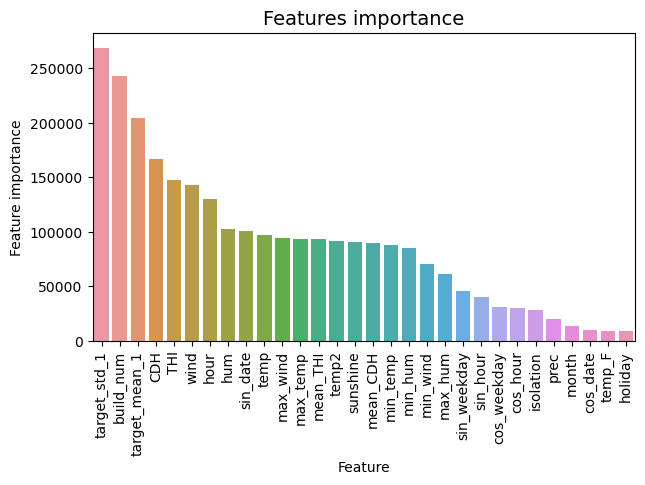

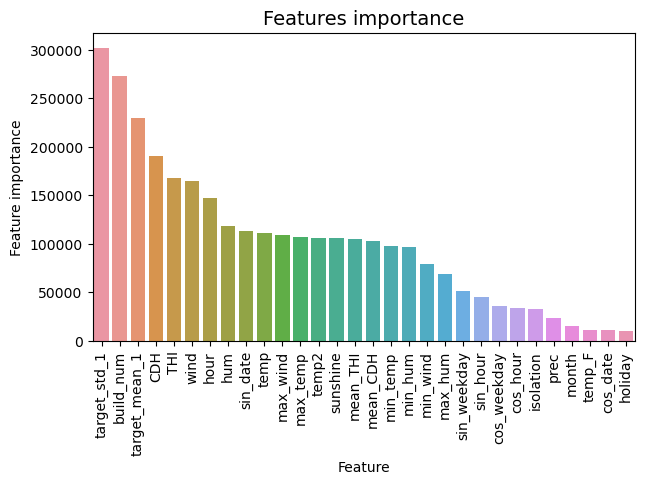

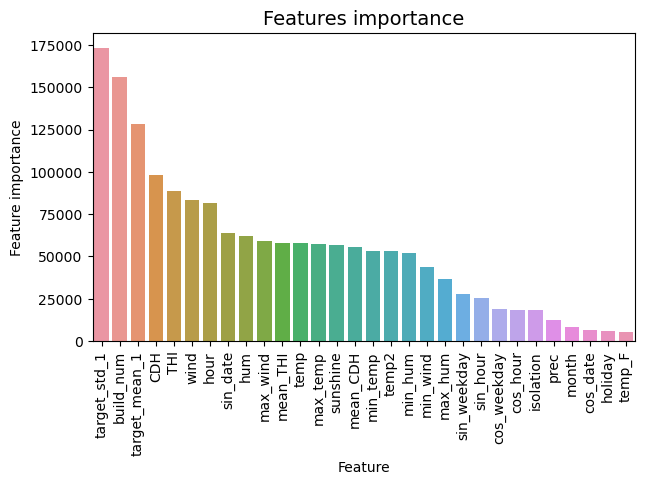

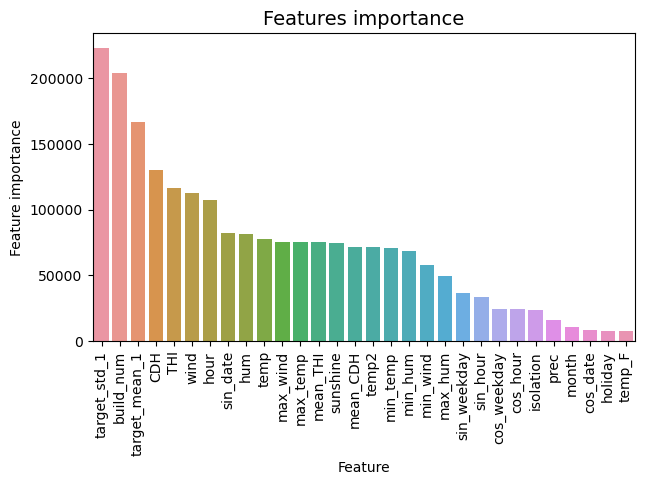

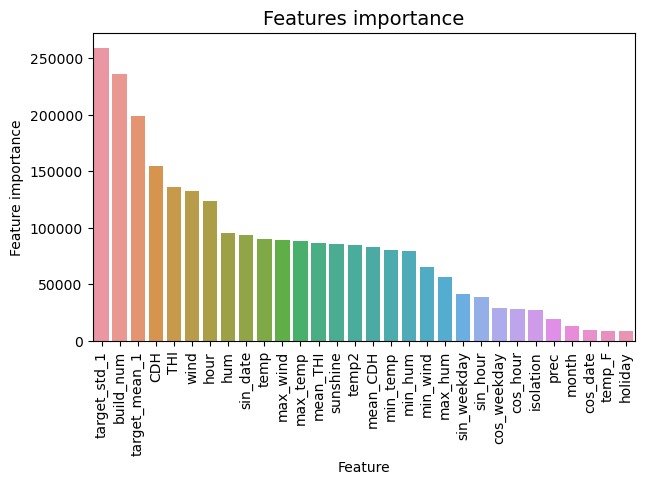

...

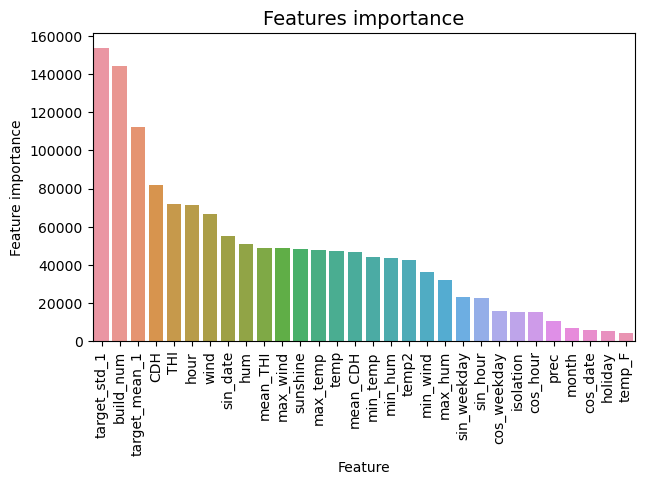

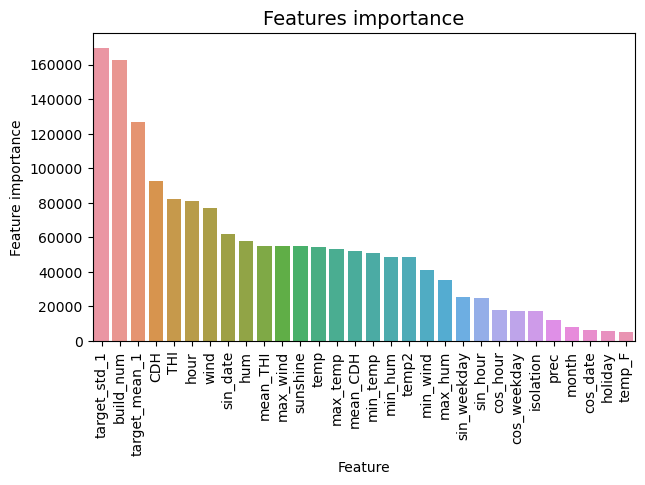

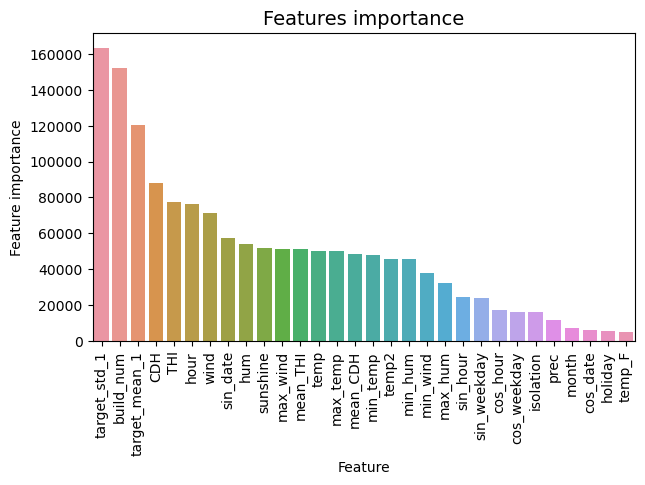

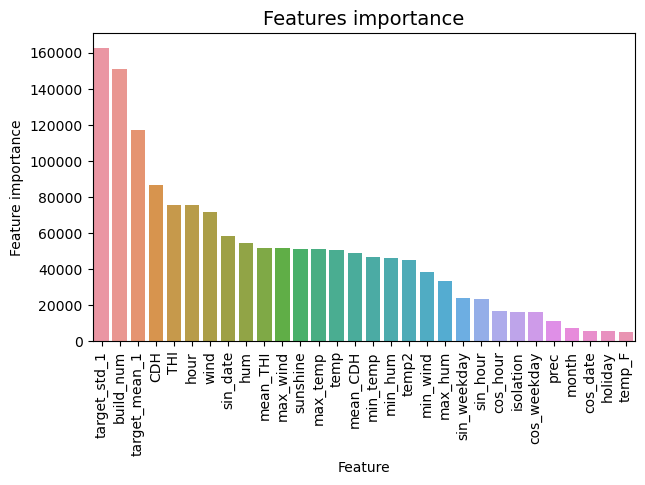

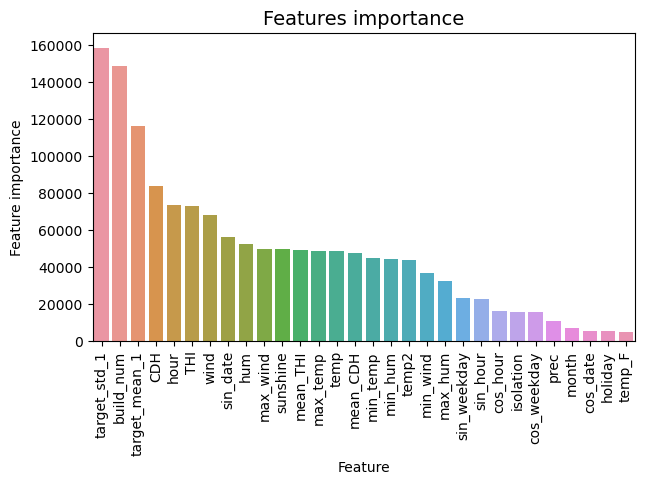

In [23]:
#LGBM feature importance
for i in range(42):
    predictors = x_train.columns
    tmp = pd.DataFrame({'Feature': predictors, 'Feature importance': models_l2[i].feature_importances_})
    tmp = tmp.sort_values(by='Feature importance',ascending=False)
    plt.figure(figsize = (7,4))
    plt.title('Features importance',fontsize=14)
    s = sns.barplot(x='Feature',y='Feature importance',data=tmp)
    s.set_xticklabels(s.get_xticklabels(),rotation=90)
    plt.show()

In [24]:
models_l1 = []

n_split_list = [3,4,5,10,20]

for split in n_split_list:
    cv = KFold(n_splits=split, shuffle=True, random_state=42)
    seed = 42
    for tri, vai in cv.split(x_train):
        print("="*50)

        model = LGBMRegressor(boosting_type='gbdt',
                            objective='regression_l1', 
                            n_estimators=iterations,
                            max_depth=12,
                            learning_rate=0.04,
                            colsample_bytree=0.9,
                            subsample=0.7,
                            num_leaves=42,
                            reg_alpha=0.01,
                            reg_lambda=0.01,
                            n_jobs=-1,
                            random_state=seed
                                    )     
        model.fit(x_train.iloc[tri], y_train[tri], 
                eval_set=[(x_train.iloc[vai], y_train[vai])], 
                eval_metric = lgbm_smape,
                early_stopping_rounds=patience ,
                verbose = 3000,
                categorical_feature=cat_features
            )

        models_l1.append(model)
        seed += 1
        if is_holdout:
            break 

C:\Users\sangw\Anaconda3\lib\site-packages\lightgbm\basic.py:1702: UserWarning: Using categorical_feature in Dataset.
  _log_warning('Using categorical_feature in Dataset.')
C:\Users\sangw\Anaconda3\lib\site-packages\lightgbm\basic.py:1705: UserWarning: categorical_feature in Dataset is overridden.
New categorical_feature is ['build_num', 'holiday', 'hour', 'month']
  _log_warning('categorical_feature in Dataset is overridden.\n'
C:\Users\sangw\Anaconda3\lib\site-packages\lightgbm\basic.py:1433: UserWarning: Overriding the parameters from Reference Dataset.
  _log_warning('Overriding the parameters from Reference Dataset.')
C:\Users\sangw\Anaconda3\lib\site-packages\lightgbm\basic.py:1245: UserWarning: categorical_column in param dict is overridden.
  _log_warning('{} in param dict is overridden.'.format(cat_alias))


Training until validation scores don't improve for 300 rounds
[3000]	valid_0's l1: 76.907	valid_0's SMAPE: 4.00928
[6000]	valid_0's l1: 73.6619	valid_0's SMAPE: 3.86726
[9000]	valid_0's l1: 71.9179	valid_0's SMAPE: 3.78809
[12000]	valid_0's l1: 70.4885	valid_0's SMAPE: 3.72822
[15000]	valid_0's l1: 69.3766	valid_0's SMAPE: 3.67696
[18000]	valid_0's l1: 68.5133	valid_0's SMAPE: 3.63268
[21000]	valid_0's l1: 67.7894	valid_0's SMAPE: 3.59773
[24000]	valid_0's l1: 67.2478	valid_0's SMAPE: 3.57419
[27000]	valid_0's l1: 66.854	valid_0's SMAPE: 3.55337
[30000]	valid_0's l1: 66.5767	valid_0's SMAPE: 3.53967
[33000]	valid_0's l1: 66.1575	valid_0's SMAPE: 3.52098
[36000]	valid_0's l1: 65.8508	valid_0's SMAPE: 3.50626
[39000]	valid_0's l1: 65.6072	valid_0's SMAPE: 3.49373
[42000]	valid_0's l1: 65.3095	valid_0's SMAPE: 3.47896
[45000]	valid_0's l1: 65.018	valid_0's SMAPE: 3.46634
[48000]	valid_0's l1: 64.7633	valid_0's SMAPE: 3.45065
[51000]	valid_0's l1: 64.5582	valid_0's SMAPE: 3.44109
[54000]	v

[3000]	valid_0's l1: 75.1303	valid_0's SMAPE: 3.90411
[6000]	valid_0's l1: 71.0513	valid_0's SMAPE: 3.73732
[9000]	valid_0's l1: 68.9969	valid_0's SMAPE: 3.64027
[12000]	valid_0's l1: 67.7183	valid_0's SMAPE: 3.57767
[15000]	valid_0's l1: 66.6613	valid_0's SMAPE: 3.53051
[18000]	valid_0's l1: 66.0461	valid_0's SMAPE: 3.50104
[21000]	valid_0's l1: 65.3602	valid_0's SMAPE: 3.4717
[24000]	valid_0's l1: 64.7296	valid_0's SMAPE: 3.43961
[27000]	valid_0's l1: 64.2147	valid_0's SMAPE: 3.41562
[30000]	valid_0's l1: 63.8522	valid_0's SMAPE: 3.3962
[33000]	valid_0's l1: 63.4727	valid_0's SMAPE: 3.3796
[36000]	valid_0's l1: 63.1084	valid_0's SMAPE: 3.36277
[39000]	valid_0's l1: 62.807	valid_0's SMAPE: 3.34758
[42000]	valid_0's l1: 62.5957	valid_0's SMAPE: 3.33725
Early stopping, best iteration is:
[42954]	valid_0's l1: 62.5311	valid_0's SMAPE: 3.3337
Training until validation scores don't improve for 300 rounds
[3000]	valid_0's l1: 74.368	valid_0's SMAPE: 3.88301
[6000]	valid_0's l1: 70.258	valid

[69000]	valid_0's l1: 59.8101	valid_0's SMAPE: 3.22988
[72000]	valid_0's l1: 59.5887	valid_0's SMAPE: 3.22099
[75000]	valid_0's l1: 59.5297	valid_0's SMAPE: 3.21746
[78000]	valid_0's l1: 59.3322	valid_0's SMAPE: 3.20271
Did not meet early stopping. Best iteration is:
[79996]	valid_0's l1: 59.2983	valid_0's SMAPE: 3.20092
Training until validation scores don't improve for 300 rounds
[3000]	valid_0's l1: 72.9407	valid_0's SMAPE: 3.8294
[6000]	valid_0's l1: 69.498	valid_0's SMAPE: 3.67391
[9000]	valid_0's l1: 67.4918	valid_0's SMAPE: 3.58939
[12000]	valid_0's l1: 66.2476	valid_0's SMAPE: 3.52535
[15000]	valid_0's l1: 64.9952	valid_0's SMAPE: 3.47374
[18000]	valid_0's l1: 64.3066	valid_0's SMAPE: 3.44072
[21000]	valid_0's l1: 63.5777	valid_0's SMAPE: 3.40348
[24000]	valid_0's l1: 63.1468	valid_0's SMAPE: 3.3847
[27000]	valid_0's l1: 62.6806	valid_0's SMAPE: 3.36292
[30000]	valid_0's l1: 62.3235	valid_0's SMAPE: 3.34814
[33000]	valid_0's l1: 61.9612	valid_0's SMAPE: 3.33345
[36000]	valid_0'

Training until validation scores don't improve for 300 rounds
[3000]	valid_0's l1: 74.7693	valid_0's SMAPE: 3.92318
[6000]	valid_0's l1: 70.2733	valid_0's SMAPE: 3.7223
[9000]	valid_0's l1: 67.9851	valid_0's SMAPE: 3.61734
[12000]	valid_0's l1: 66.5596	valid_0's SMAPE: 3.5547
[15000]	valid_0's l1: 65.3346	valid_0's SMAPE: 3.49553
[18000]	valid_0's l1: 64.7141	valid_0's SMAPE: 3.4663
[21000]	valid_0's l1: 64.0909	valid_0's SMAPE: 3.43555
[24000]	valid_0's l1: 63.1556	valid_0's SMAPE: 3.39758
[27000]	valid_0's l1: 62.7572	valid_0's SMAPE: 3.3776
[30000]	valid_0's l1: 62.3936	valid_0's SMAPE: 3.36279
[33000]	valid_0's l1: 61.9801	valid_0's SMAPE: 3.34168
[36000]	valid_0's l1: 61.6295	valid_0's SMAPE: 3.32651
[39000]	valid_0's l1: 61.3398	valid_0's SMAPE: 3.31128
[42000]	valid_0's l1: 61.0137	valid_0's SMAPE: 3.30041
[45000]	valid_0's l1: 60.7419	valid_0's SMAPE: 3.28772
[48000]	valid_0's l1: 60.6155	valid_0's SMAPE: 3.28057
[51000]	valid_0's l1: 60.516	valid_0's SMAPE: 3.2752
[54000]	vali

Training until validation scores don't improve for 300 rounds
[3000]	valid_0's l1: 72.5426	valid_0's SMAPE: 3.79151
[6000]	valid_0's l1: 68.1389	valid_0's SMAPE: 3.58279
[9000]	valid_0's l1: 65.7202	valid_0's SMAPE: 3.47279
[12000]	valid_0's l1: 64.3365	valid_0's SMAPE: 3.40066
[15000]	valid_0's l1: 63.4725	valid_0's SMAPE: 3.3578
[18000]	valid_0's l1: 62.5888	valid_0's SMAPE: 3.31236
[21000]	valid_0's l1: 61.9698	valid_0's SMAPE: 3.28255
[24000]	valid_0's l1: 61.4808	valid_0's SMAPE: 3.25946
[27000]	valid_0's l1: 60.9478	valid_0's SMAPE: 3.22297
[30000]	valid_0's l1: 60.5161	valid_0's SMAPE: 3.20283
[33000]	valid_0's l1: 60.2219	valid_0's SMAPE: 3.18841
[36000]	valid_0's l1: 59.8049	valid_0's SMAPE: 3.16697
[39000]	valid_0's l1: 59.4911	valid_0's SMAPE: 3.15385
[42000]	valid_0's l1: 59.167	valid_0's SMAPE: 3.14375
[45000]	valid_0's l1: 58.9949	valid_0's SMAPE: 3.13336
[48000]	valid_0's l1: 58.8135	valid_0's SMAPE: 3.12525
[51000]	valid_0's l1: 58.5822	valid_0's SMAPE: 3.1153
[54000]	v

[54000]	valid_0's l1: 58.8619	valid_0's SMAPE: 3.22067
[57000]	valid_0's l1: 58.7564	valid_0's SMAPE: 3.21516
[60000]	valid_0's l1: 58.6043	valid_0's SMAPE: 3.2048
[63000]	valid_0's l1: 58.3731	valid_0's SMAPE: 3.19355
[66000]	valid_0's l1: 58.1277	valid_0's SMAPE: 3.17937
[69000]	valid_0's l1: 58.0472	valid_0's SMAPE: 3.17418
[72000]	valid_0's l1: 57.9447	valid_0's SMAPE: 3.16949
[75000]	valid_0's l1: 57.86	valid_0's SMAPE: 3.16565
[78000]	valid_0's l1: 57.7399	valid_0's SMAPE: 3.16085
Did not meet early stopping. Best iteration is:
[80000]	valid_0's l1: 57.6869	valid_0's SMAPE: 3.15857
Training until validation scores don't improve for 300 rounds
[3000]	valid_0's l1: 71.0095	valid_0's SMAPE: 3.762
[6000]	valid_0's l1: 67.9732	valid_0's SMAPE: 3.62426
[9000]	valid_0's l1: 65.7538	valid_0's SMAPE: 3.52358
[12000]	valid_0's l1: 64.1345	valid_0's SMAPE: 3.4385
[15000]	valid_0's l1: 63.1098	valid_0's SMAPE: 3.38653
[18000]	valid_0's l1: 62.1604	valid_0's SMAPE: 3.33875
[21000]	valid_0's l

Training until validation scores don't improve for 300 rounds
[3000]	valid_0's l1: 70.969	valid_0's SMAPE: 3.76087
[6000]	valid_0's l1: 67.0757	valid_0's SMAPE: 3.58329
[9000]	valid_0's l1: 65.202	valid_0's SMAPE: 3.49663
[12000]	valid_0's l1: 64.2367	valid_0's SMAPE: 3.44914
[15000]	valid_0's l1: 63.1187	valid_0's SMAPE: 3.39881
[18000]	valid_0's l1: 62.3859	valid_0's SMAPE: 3.36159
[21000]	valid_0's l1: 61.9152	valid_0's SMAPE: 3.34001
[24000]	valid_0's l1: 61.481	valid_0's SMAPE: 3.32058
[27000]	valid_0's l1: 60.9411	valid_0's SMAPE: 3.29495
[30000]	valid_0's l1: 60.465	valid_0's SMAPE: 3.2728
[33000]	valid_0's l1: 60.1575	valid_0's SMAPE: 3.25592
[36000]	valid_0's l1: 59.7907	valid_0's SMAPE: 3.24044
[39000]	valid_0's l1: 59.3982	valid_0's SMAPE: 3.22048
[42000]	valid_0's l1: 59.0428	valid_0's SMAPE: 3.20103
[45000]	valid_0's l1: 58.8541	valid_0's SMAPE: 3.18951
[48000]	valid_0's l1: 58.7617	valid_0's SMAPE: 3.18444
[51000]	valid_0's l1: 58.5295	valid_0's SMAPE: 3.17439
[54000]	val

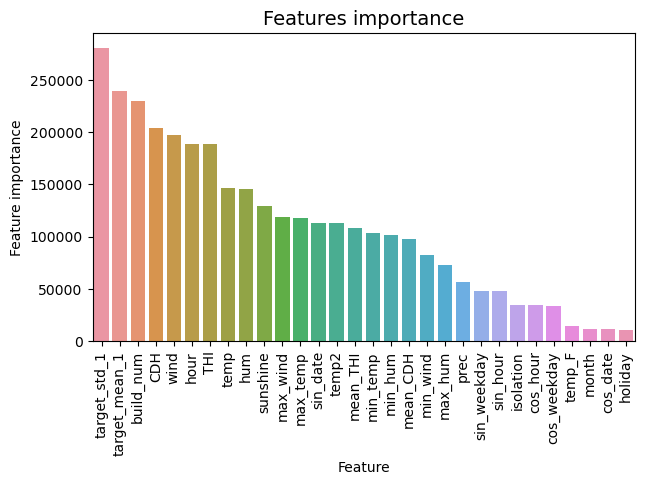

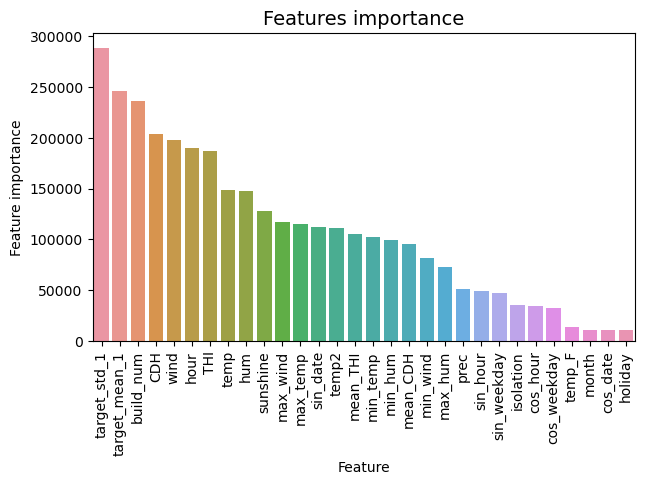

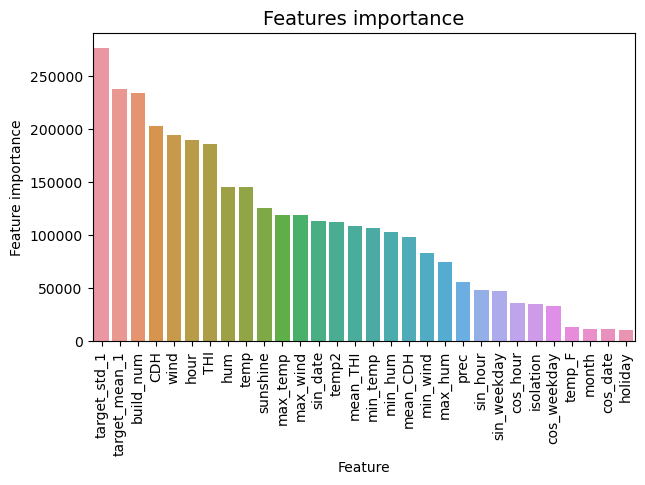

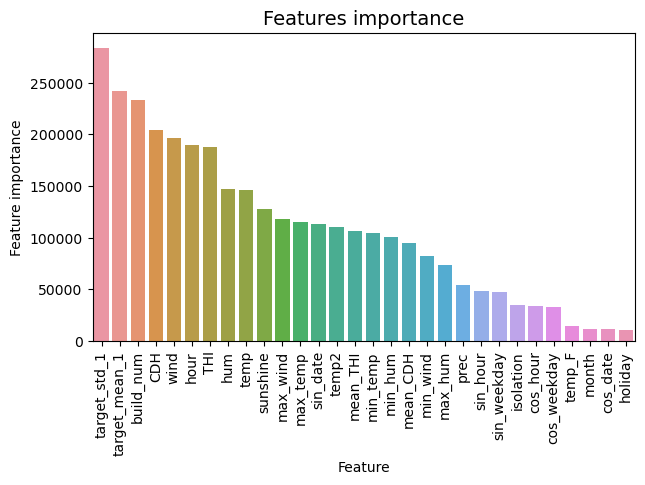

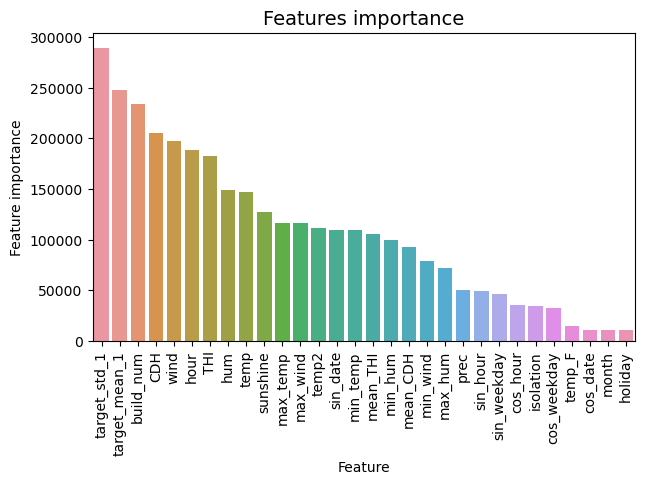

...

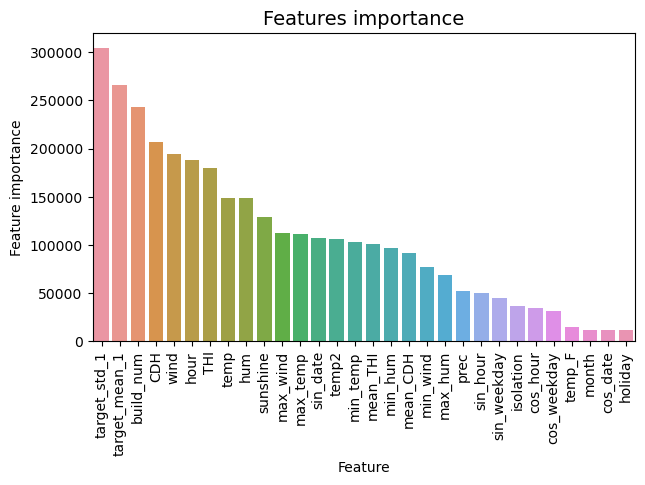

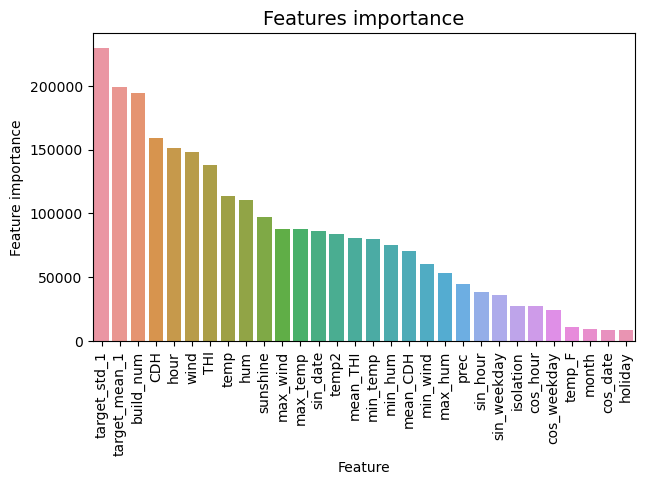

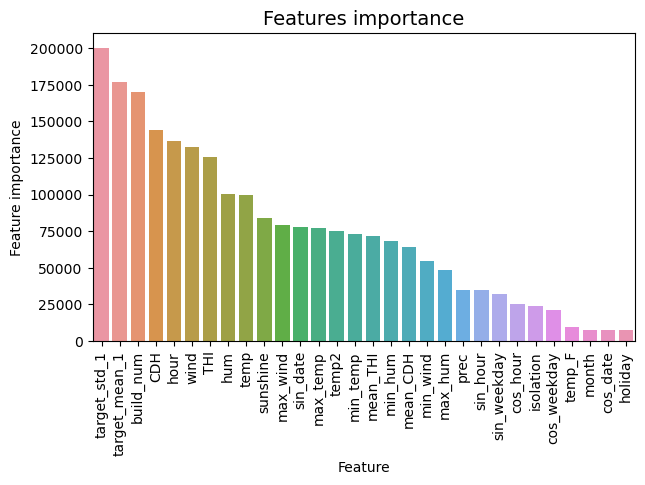

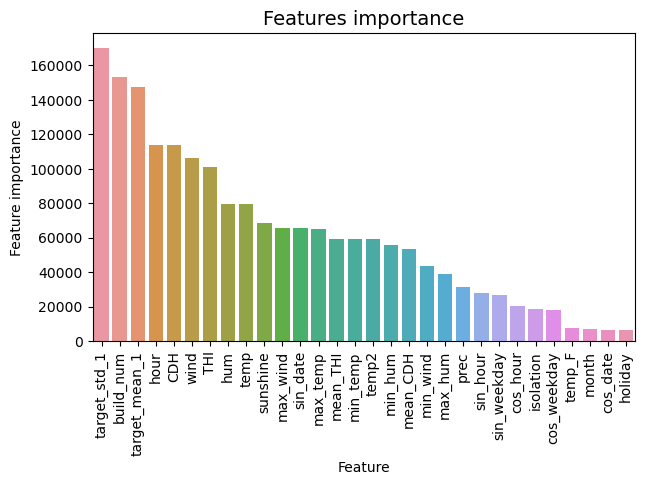

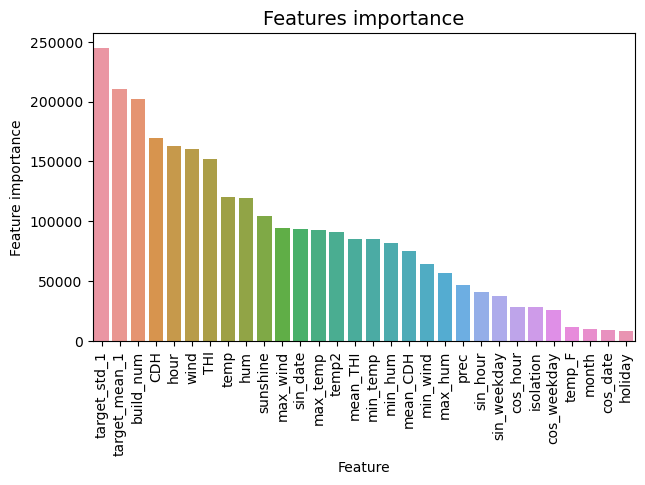

In [25]:
#LGBM feature importance
for i in range(42):
    predictors = x_train.columns
    tmp = pd.DataFrame({'Feature': predictors, 'Feature importance': models_l1[i].feature_importances_})
    tmp = tmp.sort_values(by='Feature importance',ascending=False)
    plt.figure(figsize = (7,4))
    plt.title('Features importance',fontsize=14)
    s = sns.barplot(x='Feature',y='Feature importance',data=tmp)
    s.set_xticklabels(s.get_xticklabels(),rotation=90)
    plt.show()

## 4. test inference

In [26]:
preds_l2 = []
for i in range(42):
    pred = models_l2[i].predict(x_test)
    preds_l2.append(pred)
    
preds_l2 = np.mean(preds_l2 , axis = 0 )

preds_l1 = []
for i in range(42):
    pred = models_l1[i].predict(x_test)
    preds_l1.append(pred)
    
preds_l1 = np.mean(preds_l1 , axis = 0 )

In [27]:
preds = preds_l2 * 0.5 + preds_l1 * 0.5

In [28]:
submission = pd.read_csv('./data/sample_submission.csv')
submission['answer'] = preds
submission.to_csv('./submission/lgb7_loss_seed_ensemble.csv', index = False)

## 5. post processing

In [29]:
#후처리
train_to_post = pd.read_csv('./data/train.csv')
train_to_post = train_to_post.drop(columns=['일조(hr)','일사(MJ/m2)'])

cols = ['num_date_time', 'build_num', 'date_time', 'temp','prec' ,'wind', 'hum', 'power']
train_to_post.columns = cols
date = pd.to_datetime(train_to_post.date_time)
train_to_post['hour'] = date.dt.hour
train_to_post['day'] = date.dt.weekday
train_to_post['month'] = date.dt.month
train_to_post['week'] = date.dt.weekofyear

pred_clip = []
test_to_post = pd.read_csv('./data/test.csv')
cols = ['num_date_time', 'build_num', 'date_time', 'temp','prec' ,'wind', 'hum']
test_to_post.columns = cols
date = pd.to_datetime(test_to_post.date_time)
test_to_post['hour'] = date.dt.hour
test_to_post['day'] = date.dt.weekday
test_to_post['month'] = date.dt.month
test_to_post['week'] = date.dt.weekofyear

## submission 불러오기
df = pd.read_csv('./submission/lgb7_loss_seed_ensemble.csv')

for i in range(100):

    max_data = train_to_post.loc[train_to_post.build_num == i+1, ].iloc[-28*24:, :] ## 건물별로 직전 28일의 데이터 불러오기

    ## 요일별, 시간대별 최대값 계산
    max_data = pd.pivot_table(max_data, values = 'power', index = ['day', 'hour'], aggfunc = max).reset_index()

    pred = df.answer[168*i:168*(i+1)].reset_index(drop=True) ## 168개 데이터, 즉 건물별 예측값 불러오기
    day =  test_to_post.day[168*i:168*(i+1)].reset_index(drop=True) ## 예측값 요일 불러오기
    hour = test_to_post.hour[168*i:168*(i+1)].reset_index(drop=True) ## 예측값 시간 불러오기

    df_pred = pd.concat([pred, day, hour], axis = 1)
    df_pred.columns = ['pred', 'day', 'hour']
    for j in range(len(df_pred)):

        max_power = max_data.loc[(max_data.day == df_pred.day[j])&(max_data.hour == df_pred.hour[j]), 'power'].values[0]

        if df_pred.pred[j] > max_power:
            pred_clip.append(max_power)
        else:
            pred_clip.append(df_pred.pred[j])


C:\Users\sangw\AppData\Local\Temp\ipykernel_29700\2527781750.py:11: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  train_to_post['week'] = date.dt.weekofyear
C:\Users\sangw\AppData\Local\Temp\ipykernel_29700\2527781750.py:21: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  test_to_post['week'] = date.dt.weekofyear


##### 초록색으로 표시된 값이 원래의 예측값, 주황색이 후처리된 예측값입니다.
##### 변동이 거의 없는 건물도 있으나, 유의미하게 바뀐 건물도 확인됩니다. 

C:\Users\sangw\Anaconda3\lib\site-packages\sktime\utils\plotting.py:112: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, figsize=plt.figaspect(0.25))


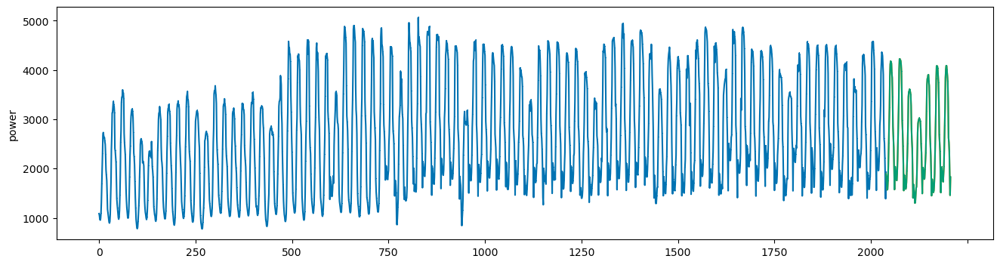

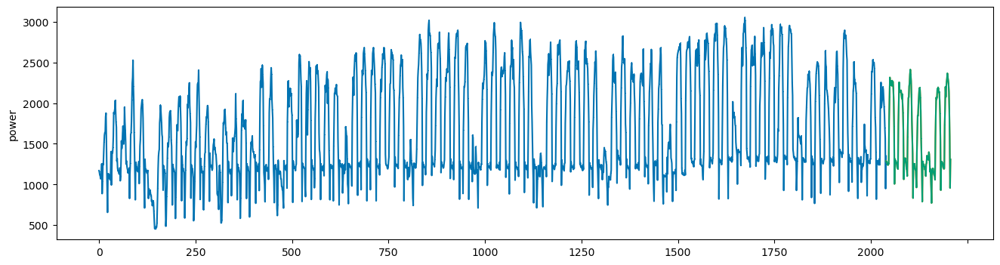

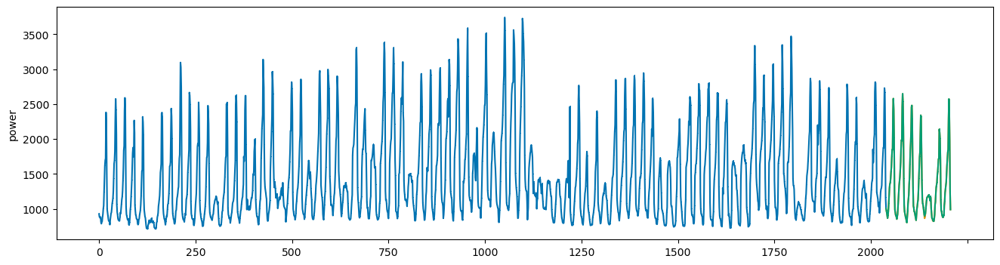

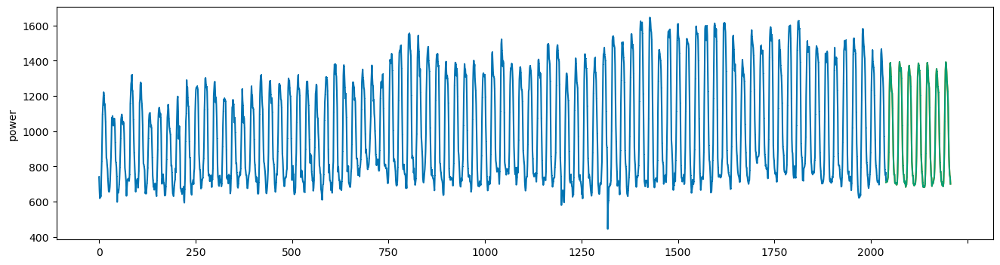

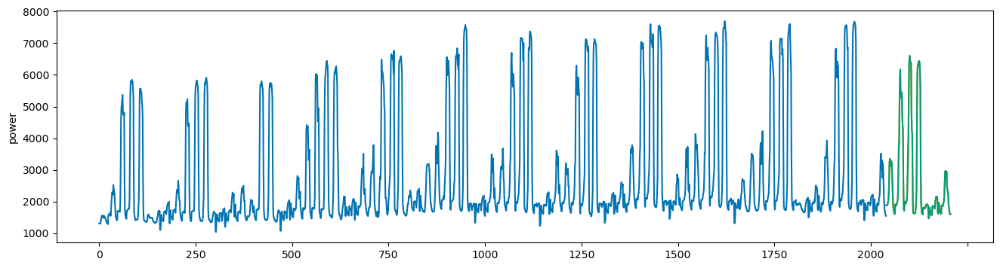

...

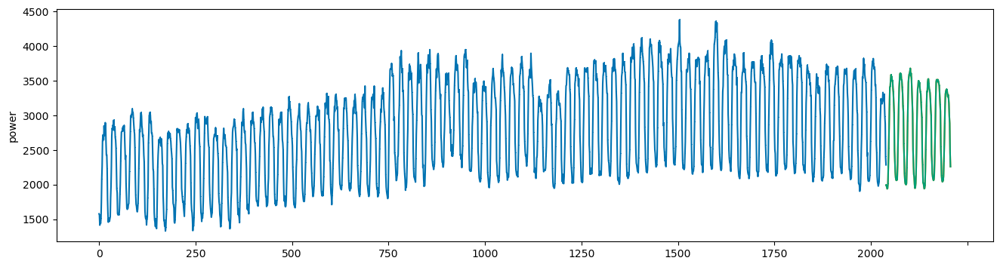

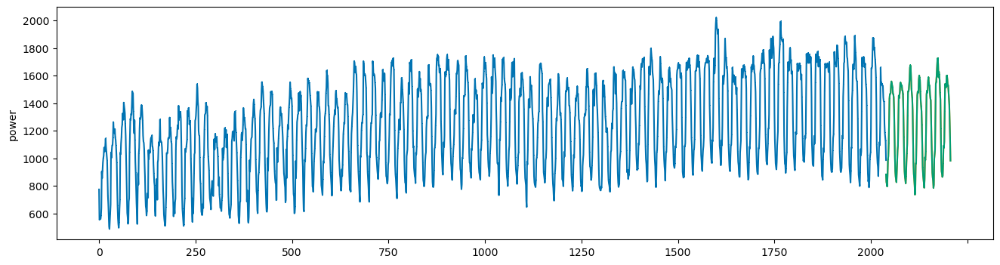

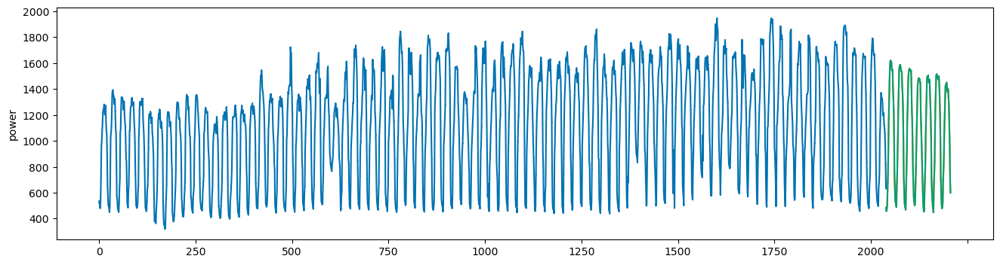

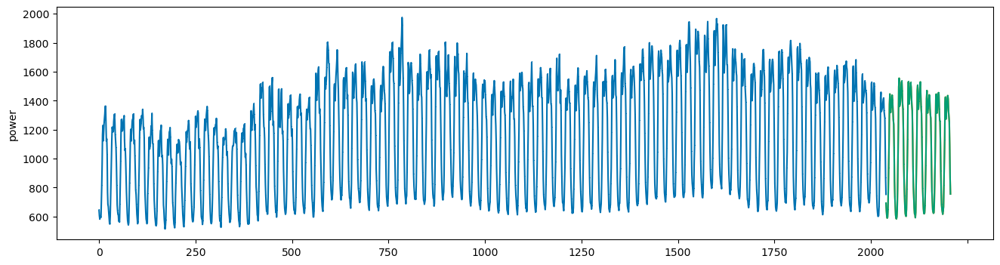

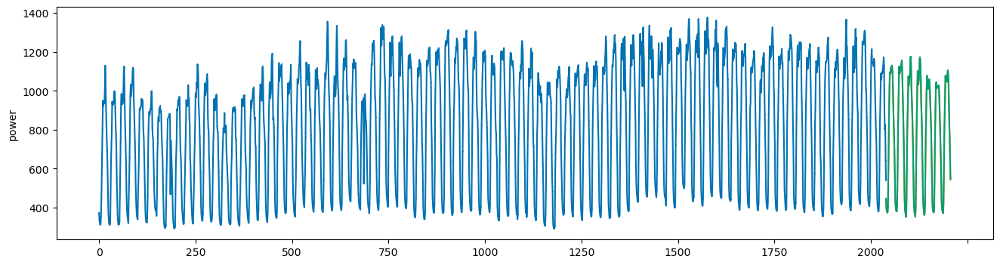

In [30]:
pred_origin = df.answer
pred_clip = pd.Series(pred_clip)

for i in range(100):
    power = train_to_post.loc[train_to_post.build_num == i+1, 'power'].reset_index(drop=True)
    preds = pred_clip[i*168:(i+1)*168]
    preds_origin = pred_origin[i*168:(i+1)*168]
    preds.index = range(power.index[-1], power.index[-1]+168)
    preds_origin.index = range(power.index[-1], power.index[-1]+168)
    
    plot_series(power, preds,  preds_origin, markers = [',', ',', ','])

#### create submission file 

In [31]:
submission = pd.read_csv('./data/sample_submission.csv')
submission['answer'] = pred_clip
submission.to_csv('./submission/lgb7_loss_seed_ensemble_finalclip.csv', index = False)